In [61]:
from PIL import Image  # for display in jupyter notebook
import matplotlib.pyplot as plt 
from tqdm import trange
import numpy as np 
import cv2

In [62]:
def show(im):
    return Image.fromarray(im[:,:,::-1])

im:  (373, 560, 3)


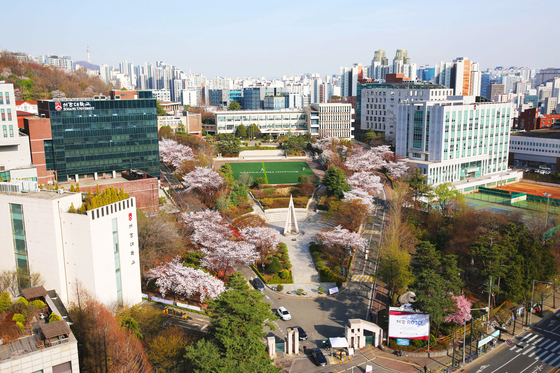

In [63]:
imagefile = 'pixels/sogang.jpg'
im = cv2.imread(imagefile)  # BGR format
print('im: ', im.shape)
show(im)

### Push
- Push each row to the right direction by $ tab = y / 2 $
- The line y=0 will be the same.
- The line y=200 will shift 200/2=100 to the right:  
    - $ x_{src} = x_{new} - y_{new}/2$.  
    - Why negative (-) sign?

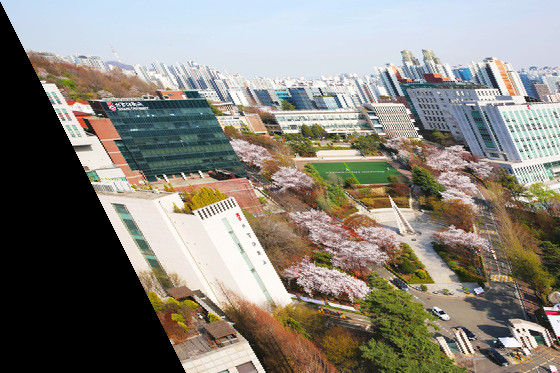

In [64]:
pushed = np.zeros_like(im)
for y in range(pushed.shape[0]):
    for x in range(pushed.shape[1]):
        ysrc = y # the same
        xsrc = x - y / 2.
        xsrc = int(xsrc) 
        if ysrc < 0 or ysrc >= im.shape[0] or xsrc < 0 or xsrc >= im.shape[1]:
            continue
        pushed[y,x] = im[ysrc, xsrc]
#
show(pushed)

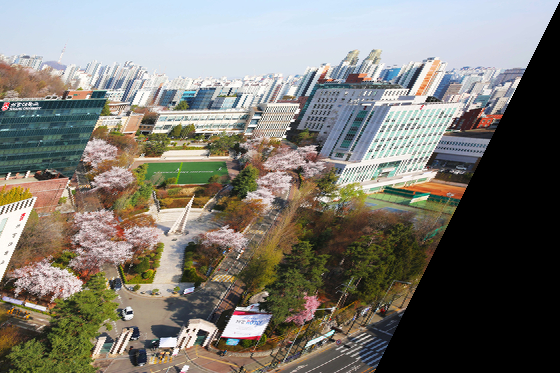

In [65]:
pushed = np.zeros_like(im)
for y in range(pushed.shape[0]):
    for x in range(pushed.shape[1]):
        ysrc = y # the same
        xsrc = x + y / 2.
        xsrc = int(xsrc) 
        if ysrc < 0 or ysrc >= im.shape[0] or xsrc < 0 or xsrc >= im.shape[1]:
            continue
        pushed[y,x] = im[ysrc, xsrc]
#
show(pushed)

We can do this by
1. compute a look-up table for all the target coordinates.
   - that is, compute the coordinates of all the source locations for all the target locations
2. use the lookup table

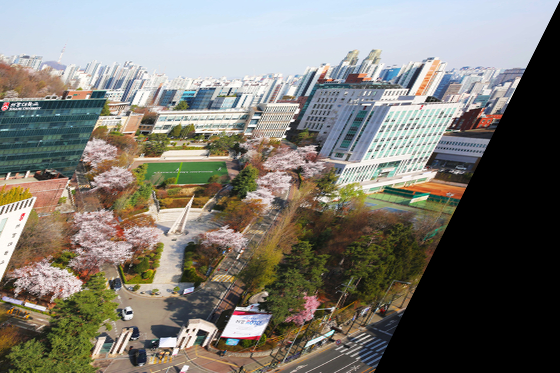

In [66]:
pushed = np.zeros_like(im)

# generate identity mapping
Y, X = np.indices( (pushed.shape[0], pushed.shape[1]), dtype="float32")

# apply coordinate transformation
Xsrc = X + Y / 2. 
Ysrc = Y 

# apply mapping with the lookup table
pushed = cv2.remap(im, Xsrc, Ysrc, cv2.INTER_LINEAR)

#
show(pushed)

Make it upside down

In [67]:
imflip = np.empty_like(im)  # result will be stored here
print(imflip.shape, imflip.dtype)

(373, 560, 3) uint8


In [68]:
%%time 
# flipping about y-axis: make upside down 
for r in range(im.shape[0]):
    rd = im.shape[0] - r - 1
    for c in range(im.shape[1]):
        for k in range(3):
            imflip[rd,c,k] = im[r,c,k]

CPU times: total: 266 ms
Wall time: 263 ms


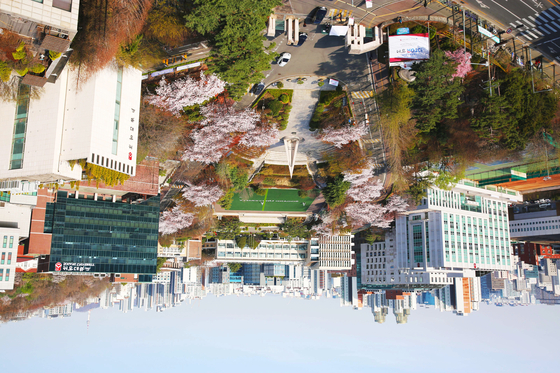

In [69]:
show(imflip)

## numpy mapy, mapx
- p = (mapx[0,0], mapy[0,0]) gives the coordinate (x, y) corresponding to (0,0) of the target/destination.

In [70]:
# numpy version of fliping
# 1. make xy maps (identity mapping)
mapy, mapx = np.indices( (im.shape[0], im.shape[1]), dtype=np.float32)
print(mapy[:3])
print(mapx[:3])

[[0. 0. 0. ... 0. 0. 0.]
 [1. 1. 1. ... 1. 1. 1.]
 [2. 2. 2. ... 2. 2. 2.]]
[[  0.   1.   2. ... 557. 558. 559.]
 [  0.   1.   2. ... 557. 558. 559.]
 [  0.   1.   2. ... 557. 558. 559.]]


Make a table of coordinate transformation/mapping.
- flipping: target(r, c) -> src(rows - 1 - r, c)
- All the y coordinates in the source image are to be calculated.

In [71]:
mapy = mapy.shape[0] - 1 - mapy
mapy[:3]

array([[372., 372., 372., ..., 372., 372., 372.],
       [371., 371., 371., ..., 371., 371., 371.],
       [370., 370., 370., ..., 370., 370., 370.]], dtype=float32)

In [72]:
(mapy[0,0], mapx[0,0])  # the target location (0,0) is connected to this source location.

(372.0, 0.0)

In [73]:
%%time 
flipped = cv2.remap(im, mapx, mapy, cv2.INTER_LINEAR)  # very fast!

CPU times: total: 0 ns
Wall time: 1.99 ms


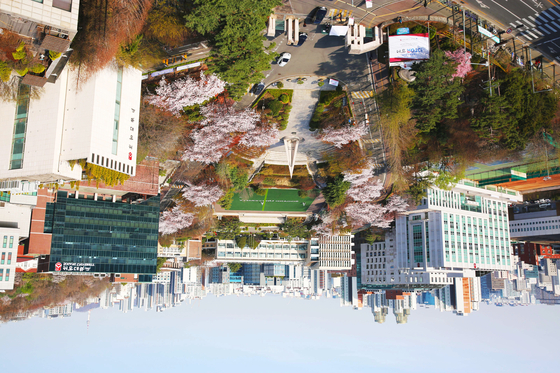

In [74]:
show(flipped)

CPU times: total: 0 ns
Wall time: 4.99 ms


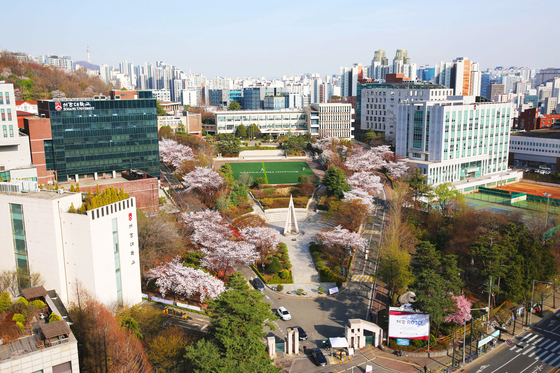

In [75]:
%%time
flipped2 = cv2.remap(flipped, mapx, mapy, cv2.INTER_LINEAR)   # double flipping gives the original.
show(flipped2)

In [76]:
%%time
np.abs(flipped2 - im).sum()  # difference must be 0

CPU times: total: 0 ns
Wall time: 1.99 ms


0

## Sin function along x-axis

$$
    w(x) = A \sin \left[\frac{2\pi}{L} (x) \right]
$$


In [77]:
L = 10
A = 2 
x = np.linspace(0, 30, 300)

def SinFunc(L, A):
    return A * np.sin( 2 * np.pi * x / L)

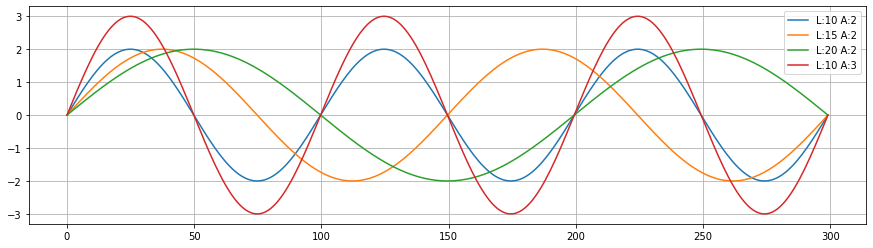

In [78]:
plt.figure(figsize=(15,4))
for L, A in [(10, 2), (15, 2), (20,2), (10, 3)]:
    plt.plot(SinFunc(L, A), label=f"L:{L} A:{A}");
plt.grid(True)
plt.legend();

(373, 560, 3)


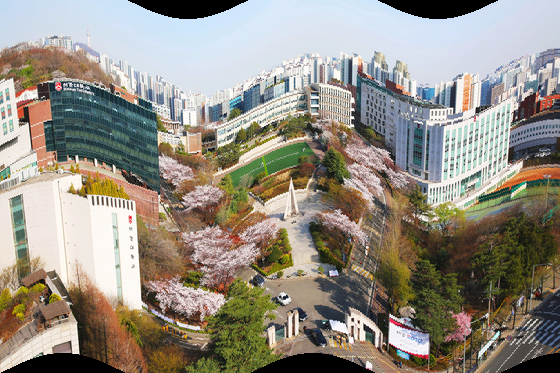

In [79]:
imSinx = np.empty_like(im)
print(imSinx.shape)

L = 250. # period of the wave
A = 20. # amplitude of the wave
for y in range(imSinx.shape[0]):
    for x in range(imSinx.shape[1]):
        yim = y + A * np.sin(2 * np.pi * x / L) 
        yim = int(yim + 0.5)  # round-up
        if yim < 0 or yim >= im.shape[0]: 
            continue 
        imSinx[y, x] = im[yim, x]
#
show(imSinx)

## Remapping (Warping) by nonlinear spatial transformation

In [80]:
# initial, identity mapping
mapy, mapyx = np.indices((im.shape[0], im.shape[1]), dtype=np.float32)

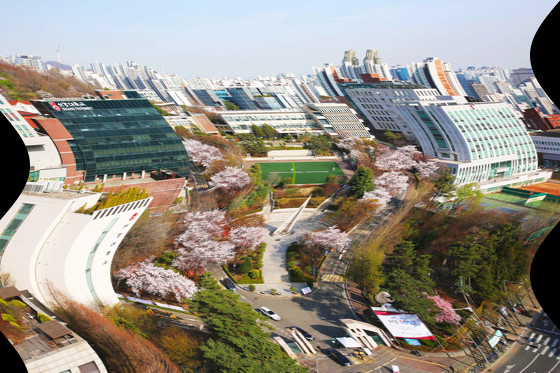

In [81]:
A = 30  # amplitude
L = 35  # wave length
sinx = mapx + A * np.sin(mapy / L)
result = cv2.remap(im, sinx, mapy, cv2.INTER_LINEAR)
show(result)

In [82]:
x = 20
for y in range(im.shape[0]):
    print(f"{y} : {(x,y)} -> {(sinx[y,x], mapy[y,x])}")

0 : (20, 0) -> (20.0, 0.0)
1 : (20, 1) -> (20.857027, 1.0)
2 : (20, 2) -> (21.713352, 2.0)
3 : (20, 3) -> (22.568281, 3.0)
4 : (20, 4) -> (23.421112, 4.0)
5 : (20, 5) -> (24.271152, 5.0)
6 : (20, 6) -> (25.117704, 6.0)
7 : (20, 7) -> (25.96008, 7.0)
8 : (20, 8) -> (26.79759, 8.0)
9 : (20, 9) -> (27.629553, 9.0)
10 : (20, 10) -> (28.455286, 10.0)
11 : (20, 11) -> (29.274117, 11.0)
12 : (20, 12) -> (30.08538, 12.0)
13 : (20, 13) -> (30.888409, 13.0)
14 : (20, 14) -> (31.68255, 14.0)
15 : (20, 15) -> (32.467155, 15.0)
16 : (20, 16) -> (33.241585, 16.0)
17 : (20, 17) -> (34.005203, 17.0)
18 : (20, 18) -> (34.757393, 18.0)
19 : (20, 19) -> (35.497536, 19.0)
20 : (20, 20) -> (36.22503, 20.0)
21 : (20, 21) -> (36.939274, 21.0)
22 : (20, 22) -> (37.639694, 22.0)
23 : (20, 23) -> (38.325718, 23.0)
24 : (20, 24) -> (38.99678, 24.0)
25 : (20, 25) -> (39.652336, 25.0)
26 : (20, 26) -> (40.29185, 26.0)
27 : (20, 27) -> (40.914803, 27.0)
28 : (20, 28) -> (41.520683, 28.0)
29 : (20, 29) -> (42.108997

Note that `cv2.remap()` does a backward mapping.

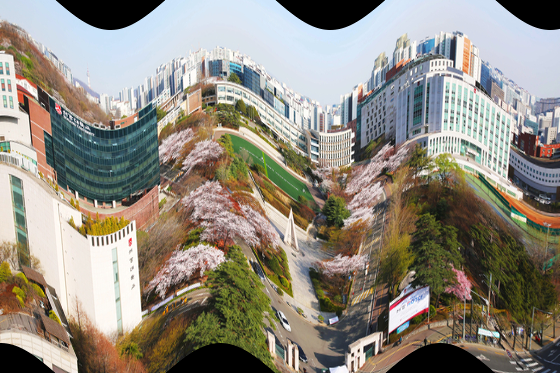

In [83]:
cosy = mapy + A * np.cos(mapx/L)
im_cosy = cv2.remap(im, mapx, cosy, cv2.INTER_LINEAR)
show(im_cosy)

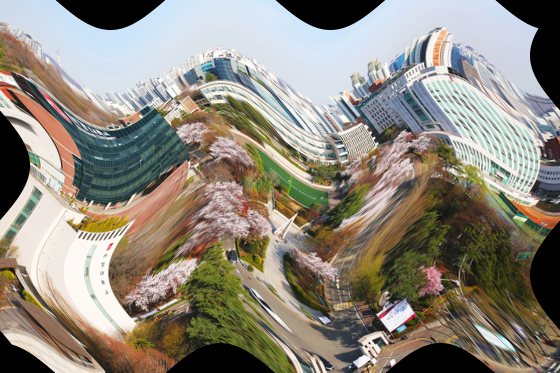

In [84]:
im_cosy_sinx = cv2.remap(im, sinx, cosy, cv2.INTER_LINEAR)
show(im_cosy_sinx)

(373, 560, 3)


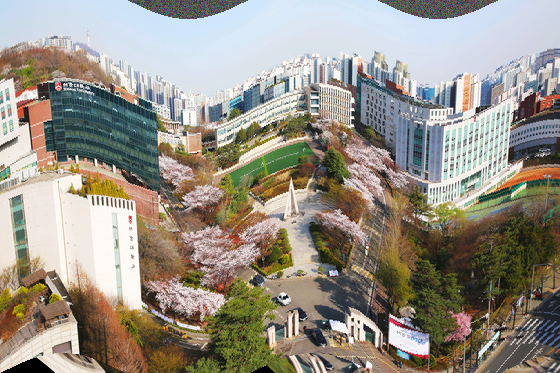

In [85]:
imSinx = np.empty_like(im)
print(imSinx.shape)

L = 250. # period of the wave
A = 20. # amplitude of the wave
for y in range(imSinx.shape[0]):
    for x in range(imSinx.shape[1]):
        yim = y + A * np.sin(2 * np.pi * x / L) 
        yim = int(yim + 0.5)  # round-up
        if yim < 0 or yim >= im.shape[0]: 
            continue 
        imSinx[y, x] = im[yim, x]
#
show(imSinx)

In [86]:
# make a function for repeated usage
def WarpSin_forloop(im, L=200, A=30):
    imSinx = np.zeros_like(im) 
    for y in range(imSinx.shape[0]):
        for x in range(imSinx.shape[1]):
            yim = y + A * np.sin(2 * np.pi * x / L) 
            yim = int(yim + 0.5)  # round-up
            if yim < 0 or yim >= im.shape[0]: 
                continue 
            imSinx[y, x] = im[yim, x]
    #
    return imSinx
#

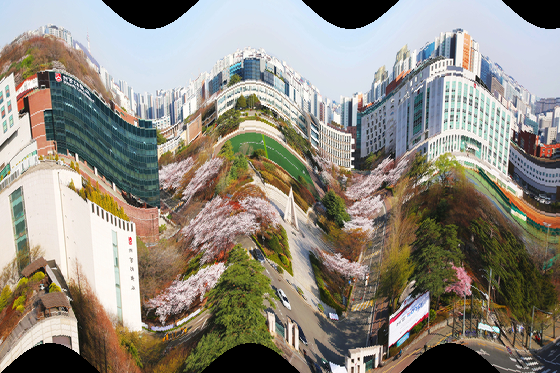

In [87]:
show(WarpSin_forloop(im))

# Interpolation
- the code use a round-up to convert yim into an integer type.
- We may apply various interpolation methods. Common ones are:
  1. Nearest Neighbor Interpolation
  2. Lienar/Bilinear interpolation
  3. Cubic/Bicubic interpolation
- Of course, this requires computation and make the process slow. We need overcome this problem by simply using a C/C++ version.

In [88]:
# make a function for repeated usage
def WarpSin_forloop_InterLinear(im, L=200, A=30):
    imSinx = np.zeros_like(im) 
    for y in range(imSinx.shape[0]):
        for x in range(imSinx.shape[1]):
            yim = y + A * np.sin(2 * np.pi * x / L) 
            if yim < 0 or yim >= im.shape[0] - 1:   # -1 for linear interpolation
                continue 
            # -----------------------------------
            iy = int(yim)
            fraction = yim - iy 
            J = im[iy, x] * (1 - fraction) + im[iy+1, x] * fraction
            # -----------------------------------
            imSinx[y, x] = J.astype(np.uint8)
    #
    return imSinx
#

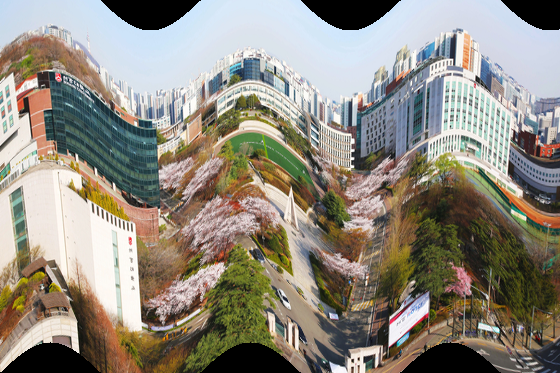

In [89]:
show( WarpSin_forloop_InterLinear(im) )

In [90]:
# make a function for repeated usage
def WarpSinXY_InterLinear(im, LX=200, AX=30, LY=200, AY=200):
    """ Sin Warping along both X, Y """
    imSinx = np.zeros_like(im) 
    for y in range(imSinx.shape[0]):
        for x in range(imSinx.shape[1]):
            yim = y + AX * np.sin(2 * np.pi * x / LX) 
            if yim < 0 or yim >= im.shape[0] - 1:   
                continue 
            xim = x + AX * np.sin(2 * np.pi * y / LY)
            if xim < 0 or xim >= im.shape[1] - 1:
                continue
            # -----------------------------------   Bi-Linear Interpolation
            ix = int(xim)
            fx = xim - ix 
            iy = int(yim)
            fy = yim - iy 
            J0 = im[iy, ix] * (1 - fy) + im[iy+1, ix] * fy
            J1 = im[iy, ix+1] * (1 - fy) + im[iy+1, ix+1] * fy
            J = J0 * (1 - fx) + J1 * fx
            # -----------------------------------
            imSinx[y, x] = J.astype(np.uint8)
    #
    return imSinx
#

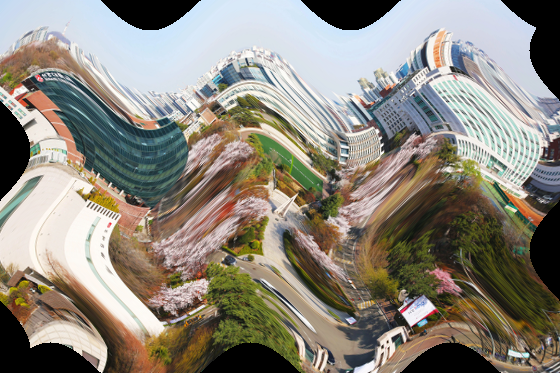

In [91]:
show(  WarpSinXY_InterLinear(im) )

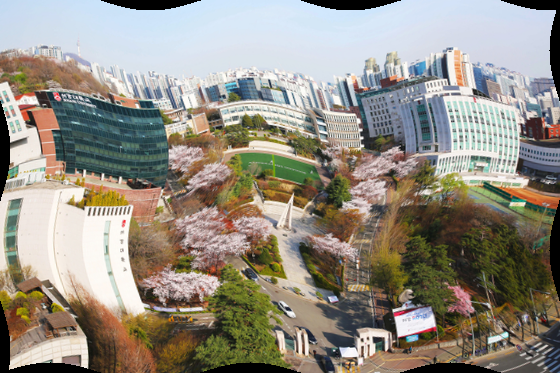

In [92]:
show(  WarpSinXY_InterLinear(im, AX=10, AY=20) )

In [93]:
# cv2.remap() is a C/C++ version by OpenCV

def WarpSin(im, L=100, A=20):
    imSinx = np.zeros_like(im)
    mapy, mapx = np.indices(im.shape[:2], dtype=np.float32)
    # print(mapx.shape)
    mapy = mapy + A * np.sin(2 * np.pi * mapx / L)
    imSinx = cv2.remap(im, mapx, mapy, cv2.INTER_LINEAR)
    return imSinx 

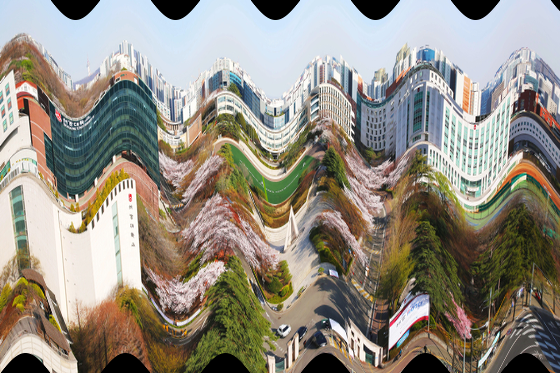

In [94]:
show(WarpSin(im))

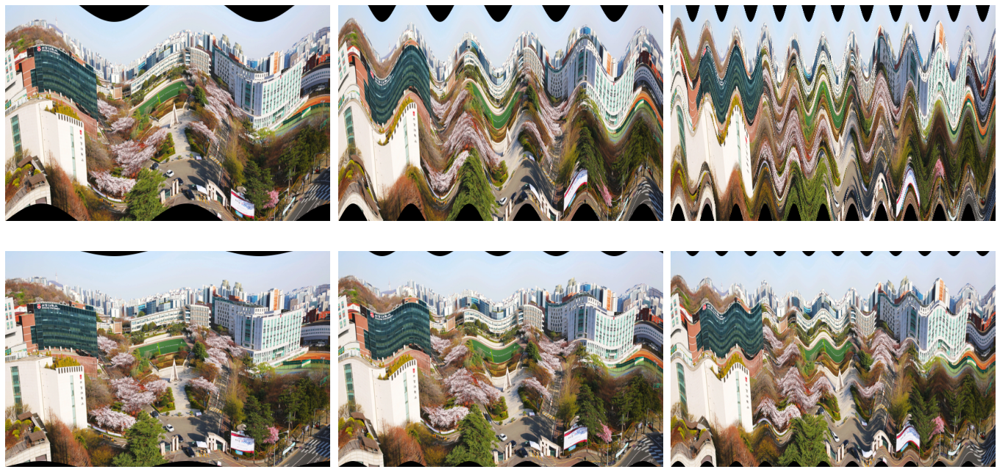

In [95]:
Lvals = [250, 100, 50]
Avals = [30, 10]
fig, axes = plt.subplots(len(Avals), len(Lvals), figsize=(19, 10))
for i, A in enumerate(Avals):
    for j, L in enumerate(Lvals):
        wim = WarpSin(im, L, A)
        axes[i,j].imshow(wim[:,:,::-1])
        axes[i,j].axis('off')
#
fig.tight_layout()

Let's make a video of warping.

- In Python programming, double for-loops is one thing that we must avoid for comptational efficiency.
- We use `cv2.remap()` which is a C/C++ implementation.


In [96]:
def VideoProperty(video):
    width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = video.get(cv2.CAP_PROP_FPS)  # this may be float such as 29.97
    nframes = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
    fourcc = int(video.get(cv2.CAP_PROP_FOURCC))
    return {"width": width, "height": height, "fps": fps, "nf": nframes, "fourcc": fourcc}

In [97]:
mp4file = "pixels/production_ID_5155396.mp4"

video = cv2.VideoCapture(mp4file)
if video == None:
    print("Video file open error: ", mp4file)

vprop = VideoProperty(video)

recorder = cv2.VideoWriter("warped_video.mp4", vprop["fourcc"], vprop["fps"], (vprop["width"], vprop["height"]) )

# prepare maps
mapy, mapx = np.indices((vprop["height"], vprop["width"]), dtype=np.float32)
A = 100
L = 300
mapy = mapy + A * np.sin(2 * np.pi * mapx / L)

# apply warping to every video frame
for i in trange(vprop["nf"]):
    ret, frame = video.read()  # extract a frame
    if ret == False: break 
    # wim = WarpSin(frame) 
    wim = cv2.remap(frame, mapx, mapy, cv2.INTER_LINEAR, borderMode=cv2.BORDER_REPLICATE)
    recorder.write(wim)
#
recorder.release()

100%|██████████| 317/317 [00:27<00:00, 11.59it/s]


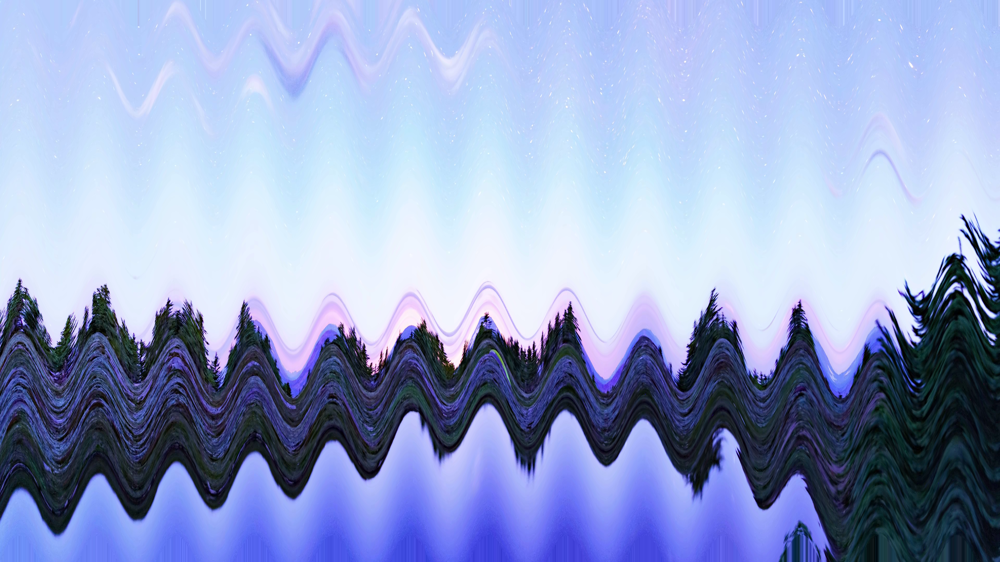

In [98]:
show( wim )

In [99]:
mp4file = "pixels/time-lapse-video-of-sunset-by-the-sea-854400.mp4"

video = cv2.VideoCapture(mp4file)
if video == None:
    print("Video file open error: ", mp4file)
print(mp4file)

vprop = VideoProperty(video)

recorder = cv2.VideoWriter("warped_video_sincos.mp4", vprop["fourcc"], vprop["fps"], (vprop["width"], vprop["height"]) )

# prepare maps
mapy, mapx = np.indices((vprop["height"], vprop["width"]), dtype=np.float32)
A = 10
L = 300
mapy = mapy + A * np.sin(2 * np.pi * mapx / L)
mapx = mapx + A * np.sin(2 * np.pi * mapy / L)
# apply warping to every video frame
for i in trange(vprop["nf"]):
    ret, frame = video.read()  # extract a frame
    if ret == False: break 
    # wim = WarpSin(frame) 
    wim = cv2.remap(frame, mapx, mapy, cv2.INTER_LINEAR, borderMode=cv2.BORDER_REPLICATE)
    recorder.write(wim)
#
recorder.release()

pixels/time-lapse-video-of-sunset-by-the-sea-854400.mp4


100%|██████████| 776/776 [00:07<00:00, 102.97it/s]


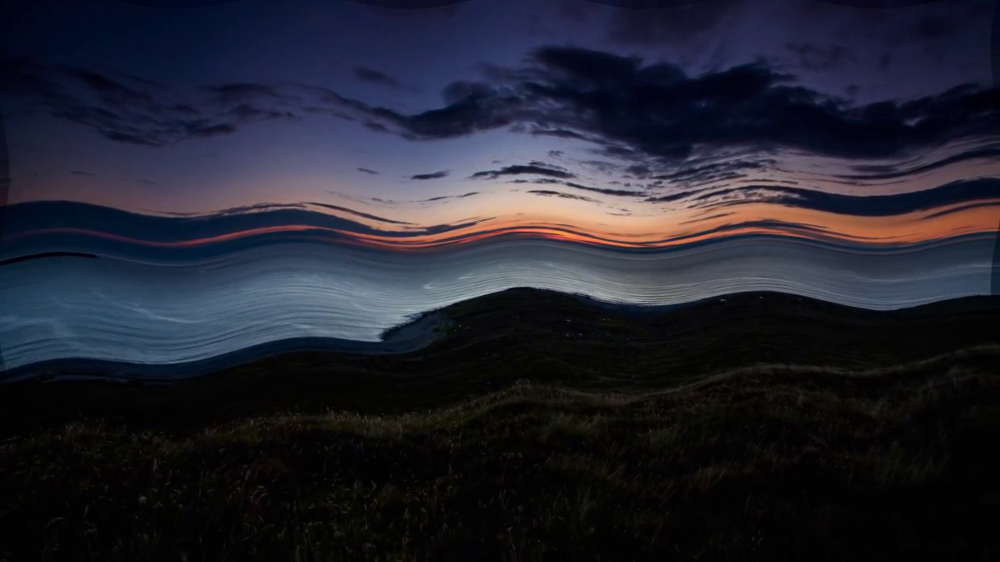

In [100]:
show(wim)

# Swilring
- Simply rotate the image
- The rotation angle changes along the distance from the center of rotation
- parameter control is necessary to produce a meaningful output.
  
1. Basic rotation
   \begin{align}
        u & = x\cos\theta + y \sin\theta \\
        v & = -x\sin\theta + y\cos\theta
   \end{align}

2. Swirling with Gaussain
    $$
        \theta(x, y) = A \cdot \exp \frac{(x-x0)^2 + (y-y0)^2}{\sigma^2}
    $$
    where $A$ is the basic rotation angle. The rotation angle decreases as (x,y) goes away from the center.
3. Swirling with a distance function
    $$
        angle(x, y) = A \cdot dist((x,y), (x_0,y_0))
    $$
    where $dist$ may be

    \begin{align}
        dist_1(x,y,x_0,y_0) & = |x-x_0| + |y-y_0| \\
        dist_2(x,y,x_0,y_0) & = \sqrt{ (x-x_0)^2 + (y-y_0)^2} \\
        dist_\infty (x,y,x_0,y_0) & = \mathrm{max} \{ |x-x_0| + |y-y_0| \}
    \end{align}

pixels/time-lapse-video-of-sunset-by-the-sea-854400.mp4
640.0 360.0


100%|██████████| 776/776 [00:08<00:00, 91.86it/s] 


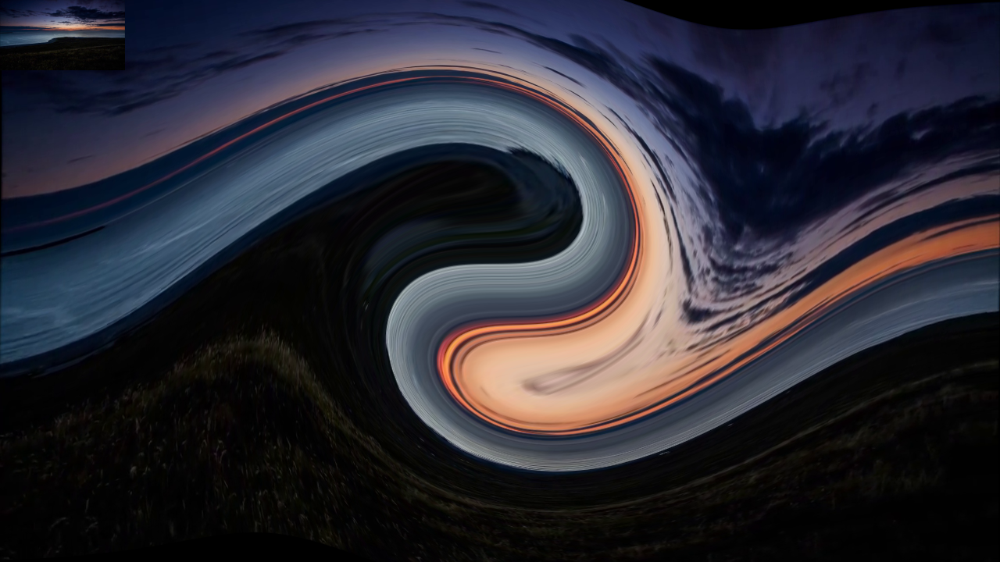

In [101]:
mp4file = "pixels/time-lapse-video-of-sunset-by-the-sea-854400.mp4"

video = cv2.VideoCapture(mp4file)
if video == None:
    print("Video file open error: ", mp4file)
print(mp4file)

vprop = VideoProperty(video)

recorder = cv2.VideoWriter("warped_video_sincos.mp4", vprop["fourcc"], vprop["fps"], (vprop["width"], vprop["height"]) )

# prepare maps
mapy, mapx = np.indices((vprop["height"], vprop["width"]), dtype=np.float32)
A = np.deg2rad(90) 
x0, y0 = vprop["width"] / 2., vprop["height"] / 2.
print(x0, y0)
# dist = np.sqrt( (mapx - x0)**2 + (mapy - y0)**2 ) * 0.005
sigmax, sigmay = 300, 300
dist = np.exp( -(((mapx - x0)/sigmax)**2 + ((mapy - y0)/sigmay)**2 ) )
theta = A * dist   # rotation angle depending on the position
mapx =   (mapx - x0) * np.cos(theta) + (mapy - y0) * np.sin(theta) + x0
mapy = - (mapx - x0) * np.sin(theta) + (mapy - y0) * np.cos(theta) + y0

# apply warping to every video frame
for i in trange(vprop["nf"]):
    ret, frame = video.read()  # extract a frame
    if ret == False: break 
    # wim = WarpSin(frame) 
    wim = cv2.remap(frame, mapx, mapy, cv2.INTER_LINEAR)
    freduced = cv2.resize(frame, (0,0), fx=1./8, fy=1./8, interpolation=cv2.INTER_AREA)
    wim[:freduced.shape[0], :freduced.shape[1]] = freduced
    recorder.write(wim)
#
recorder.release()
show (wim)

## Exercises
1. Choose a video file and apply the same procedure to get a sin-warped video.
2. Change parameters L and A.
3. Apply `sin` or `cos` to both x and y coordinates. You will need to adjust the parameters.
4. Try Swirling with parameters of your own choice.

## A progressive wave of single frequency along x-axis

$$
    w(x, t) = A \sin \left[\frac{2\pi}{L} (v t - x) \right]
$$
- The wave $w(x,t)$ propagates along the x axis.
- At a time instant $t_0$, it is a spatial wave $w(x, t_0)$ along the x axis.
- At a space location $x_0$, the signal $w(x_0, t)$ shows a sinusoidal form through time.

In [102]:
L = 10
A = 2 
v = 1
x = np.linspace(0, 30, 300)

def wave(x, t, A=10, L=200, v=1):
    return A * np.sin( 2 * np.pi * (x - v * t ) / L)

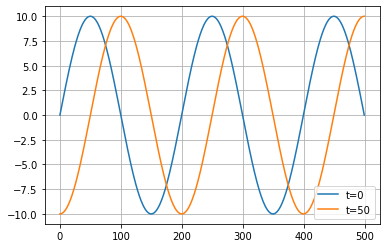

In [103]:
x = np.linspace(0, 500, 500)
for t in [0, 50]:
    plt.plot(wave(x, t=t, A=10, L=200, v=1), label=f"t={t}");
plt.grid(True)
plt.legend();

In [104]:
def wave(x, t, Amp=10, Length=200, vel=1):
    # print(f"wave: t:{t}  {Amp} {Length} {vel}")
    return Amp * np.sin( 2 * np.pi * (x - vel * t ) / Length)

In [105]:
im = cv2.imread("pixels/sogang.jpg")
recorder = cv2.VideoWriter("wave_images.mp4", cv2.VideoWriter_fourcc(*"X264"), fps=30, frameSize=(im.shape[1], im.shape[0]))
Y0, X0 = np.indices(im.shape[:2], dtype=np.float32)
t = 0
delta = 0.1
while t < 300:
    Y = Y0 + wave(X, t=t, Amp=25, Length=200, vel=1)
    X = X0 
    warped = cv2.remap(im, X, Y, cv2.INTER_LINEAR)
    recorder.write(warped)
    t += 1
#
recorder.release()

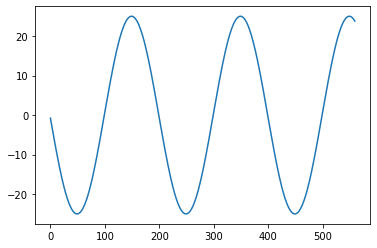

In [106]:
plt.plot(X[0], Y[0]);

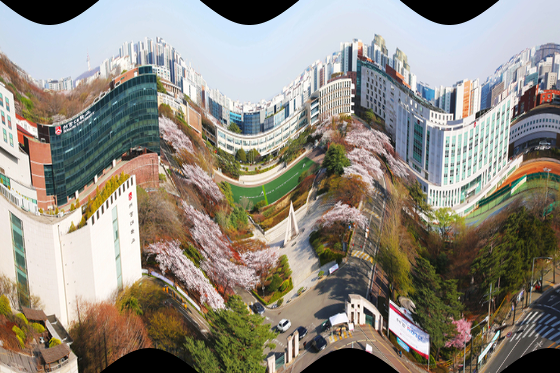

In [107]:
show(warped)

280 186 0.0 0.03141593


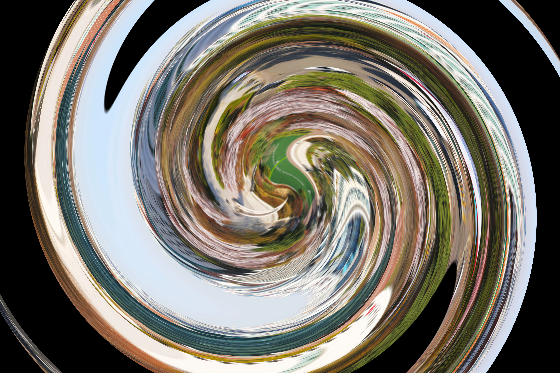

In [108]:
im = cv2.imread("pixels/sogang.jpg")
recorder = cv2.VideoWriter("wave_images.mp4", cv2.VideoWriter_fourcc(*"X264"), fps=30, frameSize=(im.shape[1], im.shape[0]))
Y0, X0 = np.indices(im.shape[:2], dtype=np.float32)
t = 0
h, w = im.shape[:2]  # swirling center will be the image center
xc, yc = w//2, h//2
scale = w / 2. 
dmap = np.sqrt( (np.abs(X0 - xc)/scale)**2 + (np.abs(Y0 - yc)/scale)**2 )
dmap /= dmap.max()
dmap = dmap * np.pi / 100
print(xc, yc, dmap.min(), dmap.max())
while t < 300:
    angle = dmap * t 
    X = (X0 - xc) * np.cos(angle) + (Y0 - yc) * np.sin(angle)  + xc
    Y = - (X0 - xc) * np.sin(angle) + (Y0 - yc) * np.cos(angle) + yc 
    warped = cv2.remap(im, X, Y, cv2.INTER_LINEAR)
    recorder.write(warped)
    t += 1
#
recorder.release()
show(warped)

280 186 0.0018634232 0.03141593


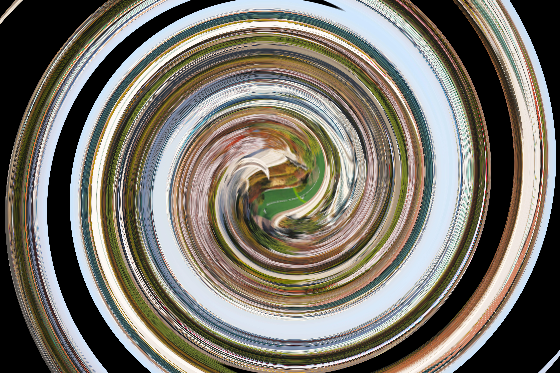

In [109]:
im = cv2.imread("pixels/sogang.jpg")
recorder = cv2.VideoWriter("wave_images.mp4", cv2.VideoWriter_fourcc(*"X264"), fps=30, frameSize=(im.shape[1], im.shape[0]))
Y0, X0 = np.indices(im.shape[:2], dtype=np.float32)
t = 0
h, w = im.shape[:2]  # swirling center will be the image center
xc, yc = w//2, h//2
scale = 200. 
dmap = np.exp( -(np.abs(X0 - xc)/scale)**2 + -(np.abs(Y0 - yc)/scale)**2 )
# dmap /= dmap.max()
dmap = dmap * np.pi / 100
print(xc, yc, dmap.min(), dmap.max())
while t < 500:
    angle = dmap * t 
    X = (X0 - xc) * np.cos(angle) + (Y0 - yc) * np.sin(angle)  + xc
    Y = - (X0 - xc) * np.sin(angle) + (Y0 - yc) * np.cos(angle) + yc 
    warped = cv2.remap(im, X, Y, cv2.INTER_LINEAR)
    recorder.write(warped)
    t += 1
#
recorder.release()
show(warped)

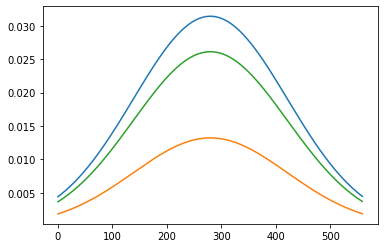

In [110]:
plt.plot(dmap[yc])
plt.plot(dmap[0]); plt.plot(dmap[100])

End.